In [28]:
from skimage.color import rgb2gray, rgb2lab, deltaE_cie76
import numpy as np
import cv2
import matplotlib.pyplot as plt
import os

In [29]:
SITE_NAME = "NEON.D01.HARV.DP1.00033"
YEAR      = 2020

In [30]:
def list_files(filepath, filetype):
   paths = []
   for root, dirs, files in os.walk(filepath):
      for file in files:
         if file.lower().endswith(filetype.lower()):
            paths.append(os.path.join(root, file))
   return(paths)

img_files = list_files(f'../data_raw/{SITE_NAME}/{YEAR}', ".jpg")
img_files.sort() # due to the way the file name is set up, sorting will sort it by date as well
img_files

['../data_raw/NEON.D01.HARV.DP1.00033/2020/01/NEON.D01.HARV.DP1.00033_2020_01_01_120006.jpg',
 '../data_raw/NEON.D01.HARV.DP1.00033/2020/01/NEON.D01.HARV.DP1.00033_2020_01_02_120006.jpg',
 '../data_raw/NEON.D01.HARV.DP1.00033/2020/01/NEON.D01.HARV.DP1.00033_2020_01_03_120006.jpg',
 '../data_raw/NEON.D01.HARV.DP1.00033/2020/01/NEON.D01.HARV.DP1.00033_2020_01_04_120005.jpg',
 '../data_raw/NEON.D01.HARV.DP1.00033/2020/01/NEON.D01.HARV.DP1.00033_2020_01_05_120006.jpg',
 '../data_raw/NEON.D01.HARV.DP1.00033/2020/01/NEON.D01.HARV.DP1.00033_2020_01_06_120006.jpg',
 '../data_raw/NEON.D01.HARV.DP1.00033/2020/01/NEON.D01.HARV.DP1.00033_2020_01_07_120006.jpg',
 '../data_raw/NEON.D01.HARV.DP1.00033/2020/01/NEON.D01.HARV.DP1.00033_2020_01_08_120006.jpg',
 '../data_raw/NEON.D01.HARV.DP1.00033/2020/01/NEON.D01.HARV.DP1.00033_2020_01_09_120006.jpg',
 '../data_raw/NEON.D01.HARV.DP1.00033/2020/01/NEON.D01.HARV.DP1.00033_2020_01_10_120005.jpg',
 '../data_raw/NEON.D01.HARV.DP1.00033/2020/01/NEON.D01.HARV.

In [31]:
def process_image(image_name):
    image = cv2.imread(image_name)
    rgb_img = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
#     plt.imshow(rgb_img)
#     plt.show()
    gray_img = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
#     plt.imshow(gray_img, cmap='gray')
#     plt.show()
    average_color_row = np.average(gray_img, axis=0)
    average_color = np.average(average_color_row, axis=0)
    return average_color

In [40]:
threshold = 116
above_threshold = []
below_threshold = []
for filename in img_files:
    gray_avg = process_image(filename)
#     print(gray_avg)
    if gray_avg > threshold:
        above_threshold.append((filename, gray_avg))
    else:
        below_threshold.append((filename, gray_avg))

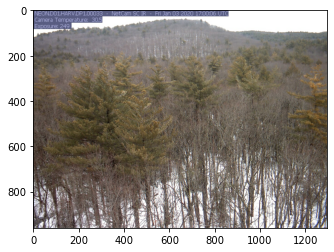

116.32667663323046


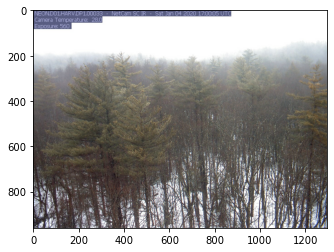

133.15090020576133


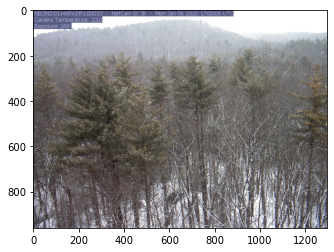

123.5580463927469


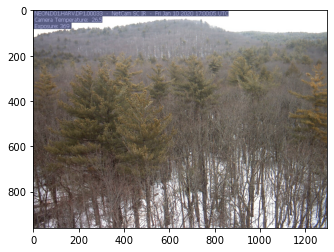

117.137103748714


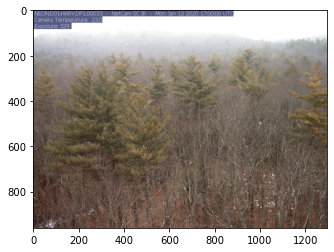

122.79594827031893


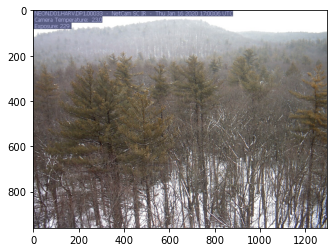

122.82233474794239


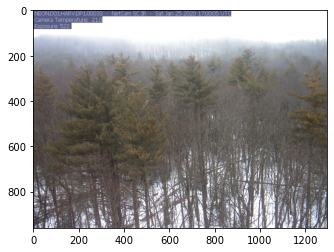

128.8617629565329


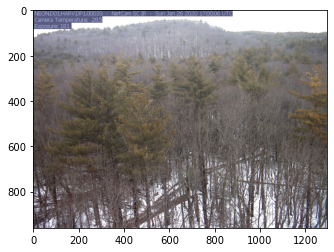

117.37737590020576


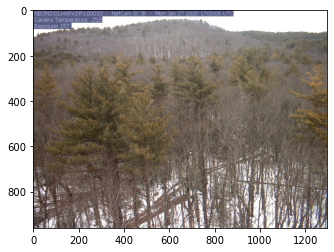

116.69028903034977


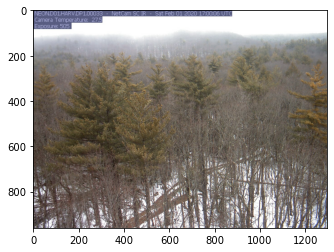

124.4078695666152


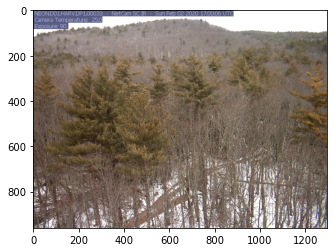

117.12622733410495


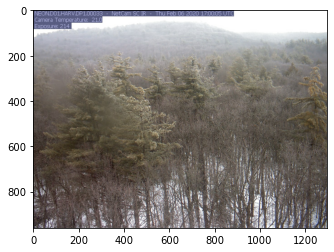

120.99190216692385


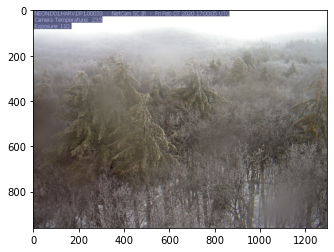

126.04509870113168


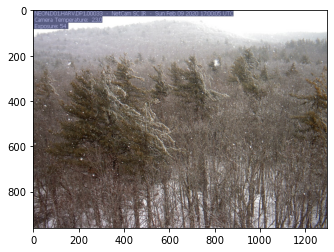

120.62402986754115


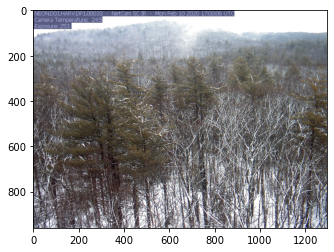

123.79541538065844


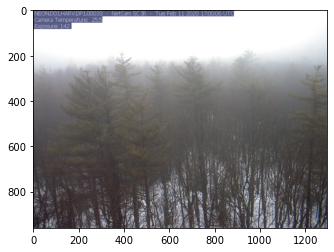

129.7423426247428


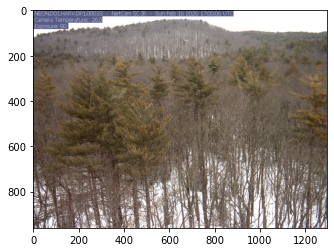

116.28520447530865


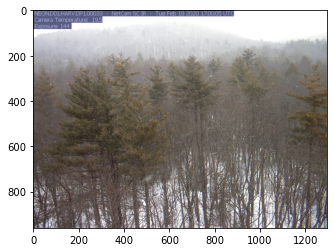

126.40918692129631


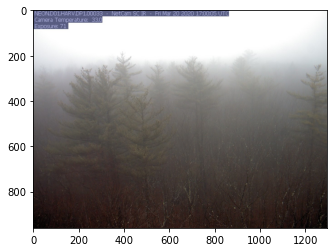

122.18013036908438


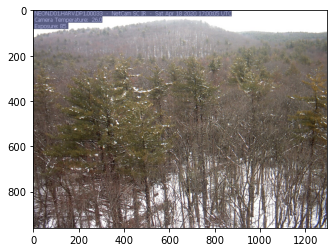

118.85687853652264


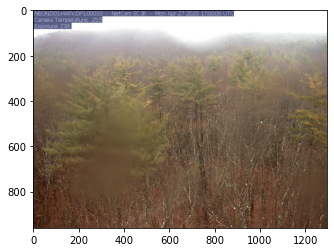

118.24071743184156


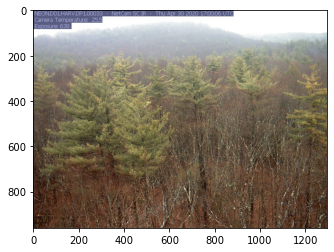

117.74023919753084


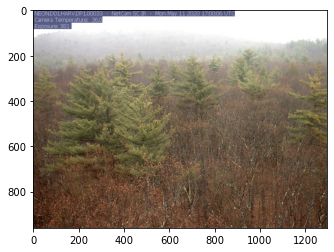

121.75415219907408


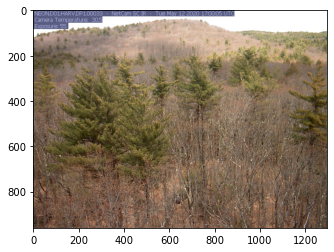

116.69446694958849


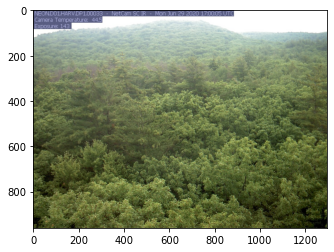

117.33928433641977


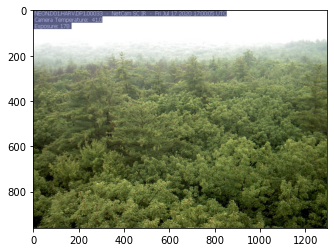

125.9458381558642


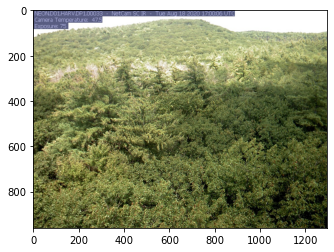

119.13546971450617


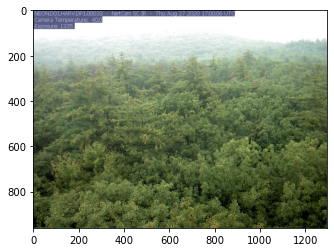

123.59914239326133


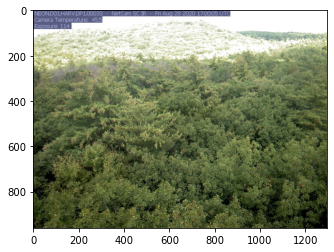

119.46895495756173


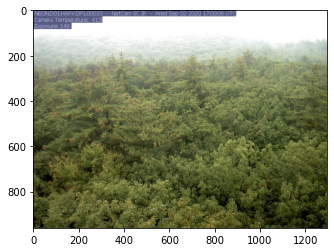

123.28035140174897


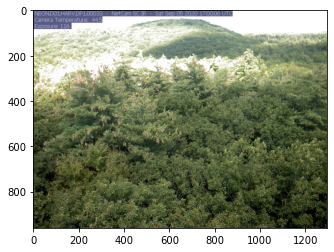

117.78141075102882


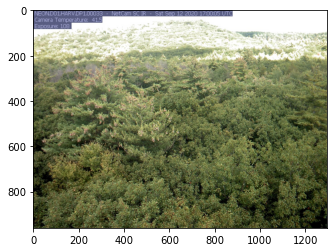

121.54456018518519


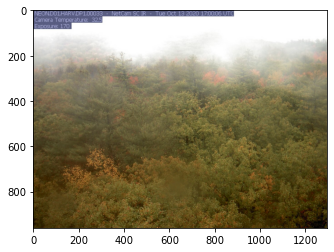

124.83951260288066


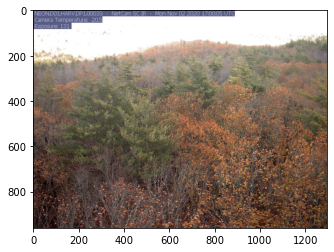

120.4125675154321


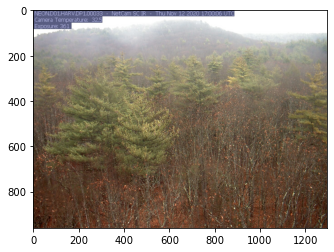

116.62831870498972


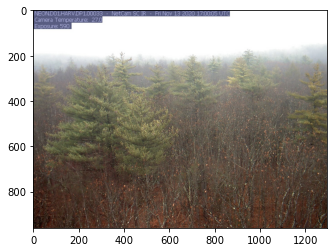

126.12469216177982


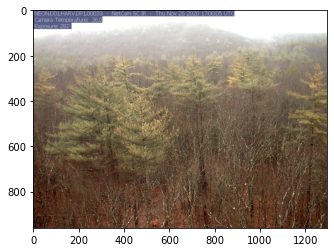

119.00303176440327


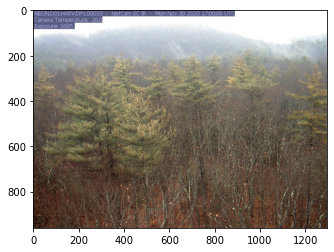

120.14676247427984


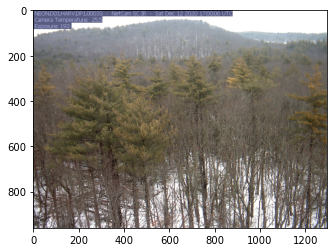

117.74258535879629


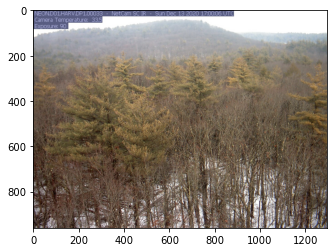

117.44548289609052


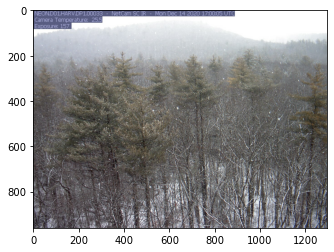

124.91496752829218


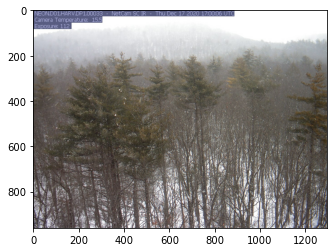

125.6772850758745


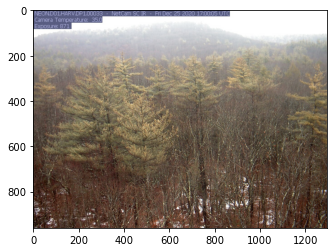

119.02931053883744


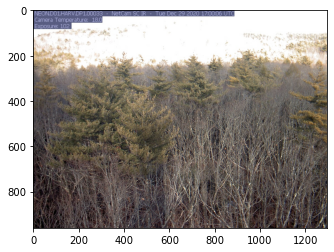

123.70797646604936


In [41]:
for filename, gray_avg in above_threshold:
    image = cv2.imread(filename)
    rgb_img = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
    plt.imshow(rgb_img)
    plt.show()
    print(gray_avg)

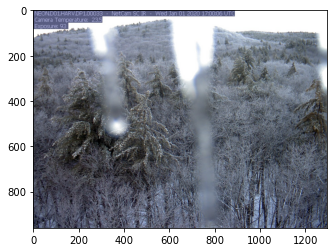

115.09052051183127


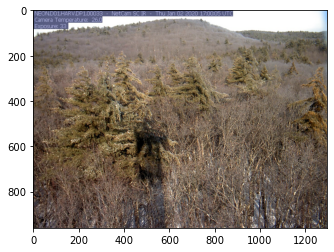

108.02288773148146


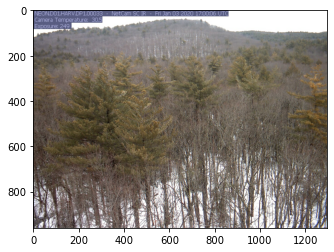

116.32667663323046


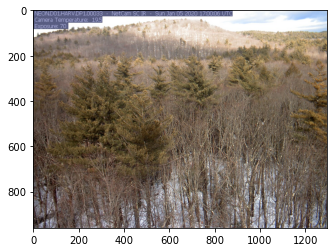

114.19896637088478


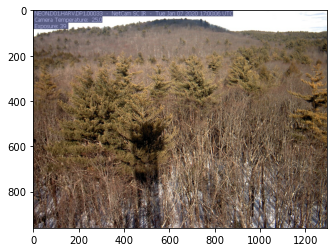

105.83176199202677


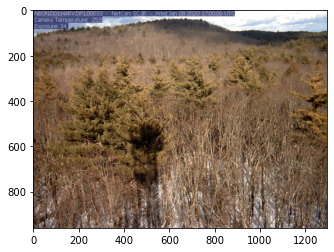

106.45061808770576


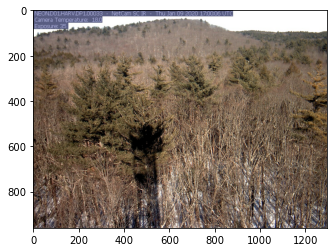

106.3823615933642


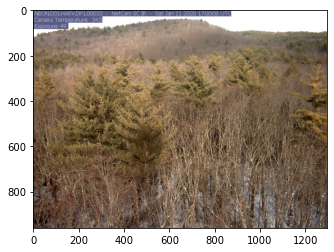

111.49622878086419


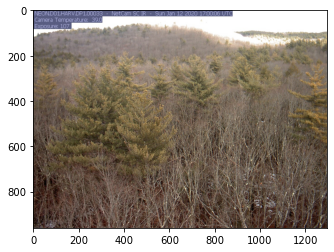

111.15541248713994


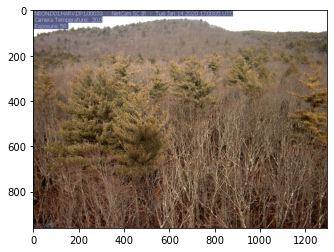

105.20741303369343


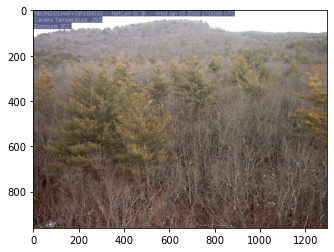

113.05038901748969


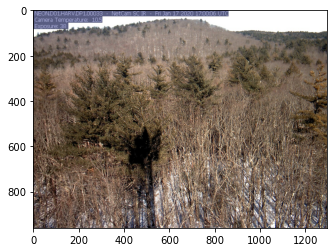

107.0904658564815


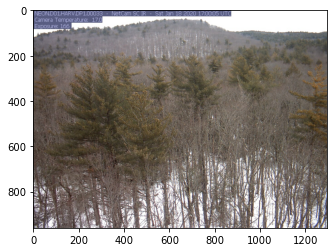

114.69791988168723


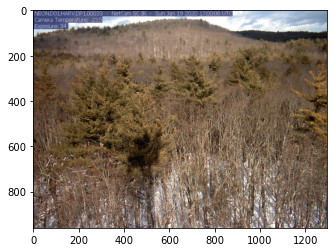

104.78822579089508


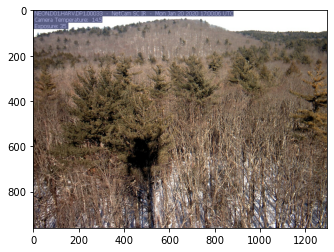

107.27855179398148


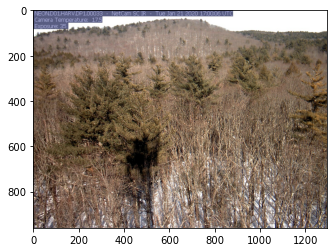

114.00757056970163


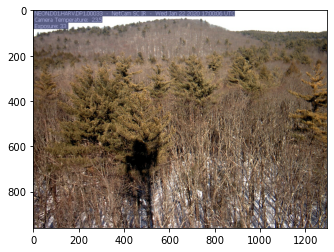

106.57016782407408


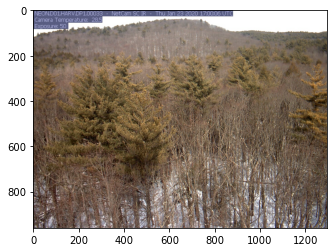

110.40954459233538


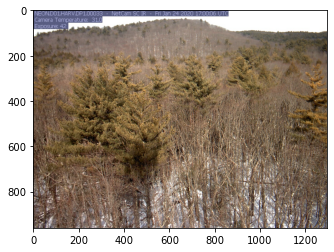

114.11449893904322


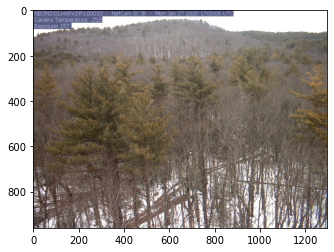

116.69028903034977


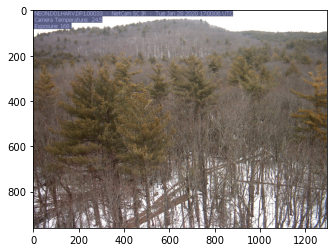

114.36732011959876


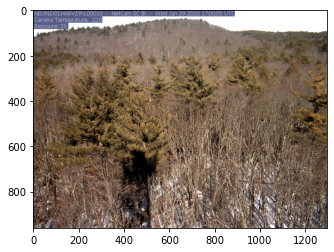

107.57933304398149


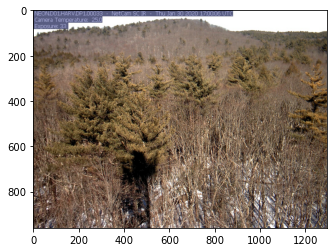

108.55880996013374


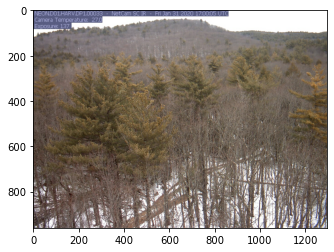

114.16765046296295


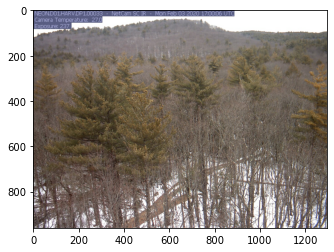

114.8806351273148


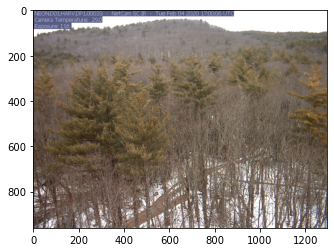

115.51962207433128


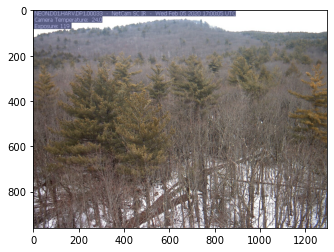

115.4195786715535


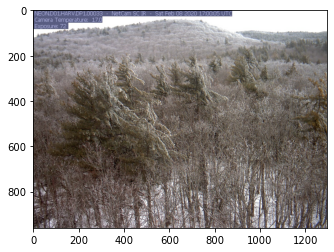

114.8937845614712


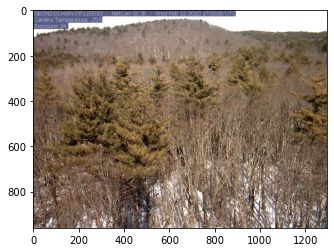

115.02820859053499


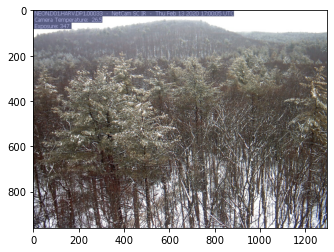

115.87041939943416


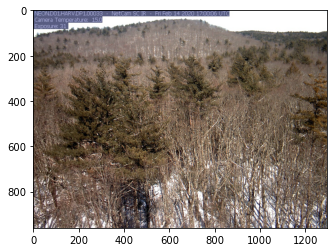

108.3935619212963


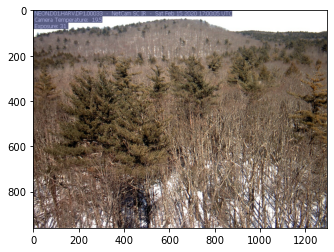

110.3015625


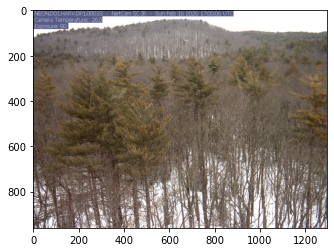

116.28520447530865


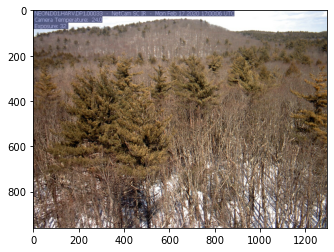

110.3727840470679


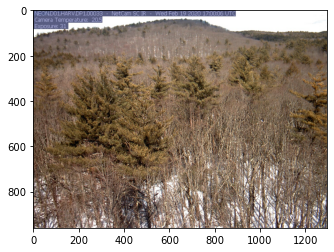

114.34706227494857


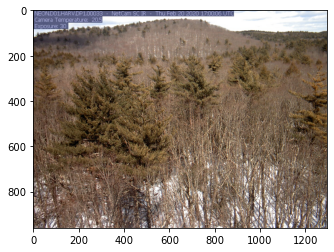

108.92663724922839


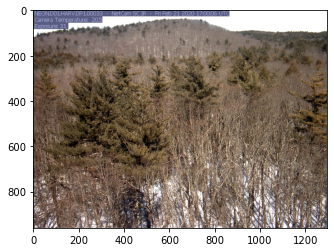

109.22231385030867


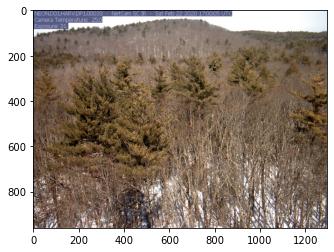

110.70043000900203


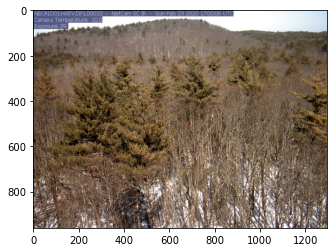

107.00869582690328


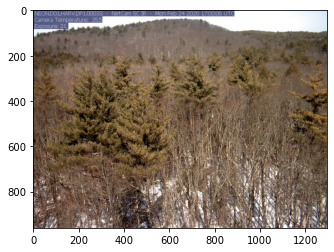

107.07278243955761


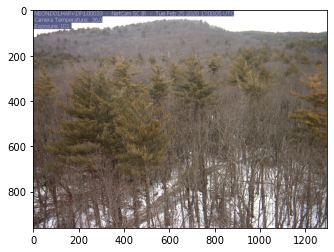

113.62772633744855


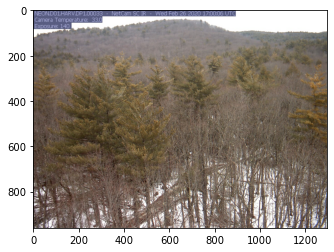

114.60005063657407


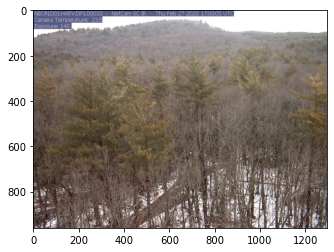

115.24057436342592


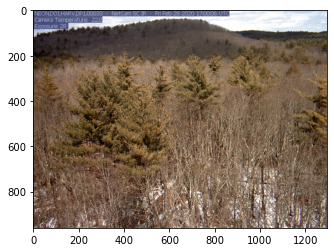

103.48295556841562


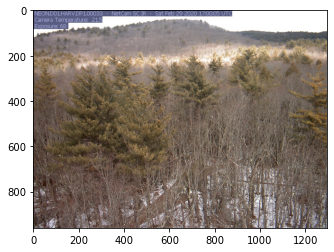

115.75459828317902


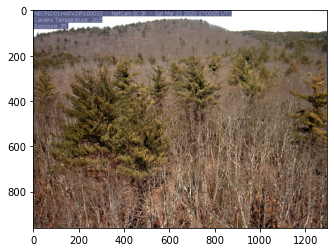

104.78879324202677


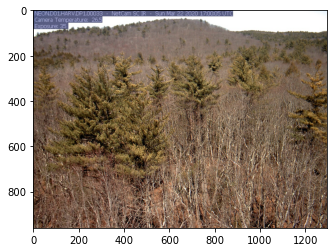

106.2975742669753


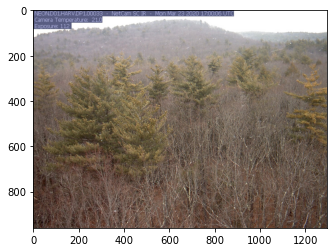

115.59858297968107


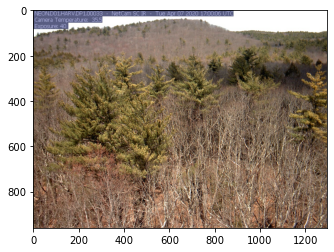

113.17849633487656


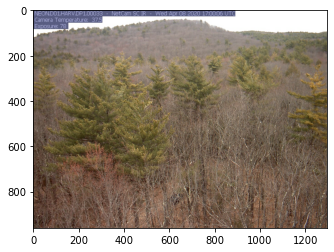

112.93984374999998


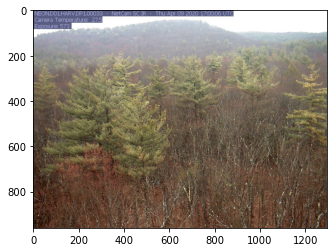

115.72223106352882


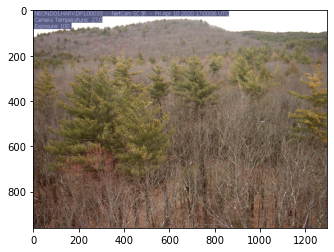

112.20901331018518


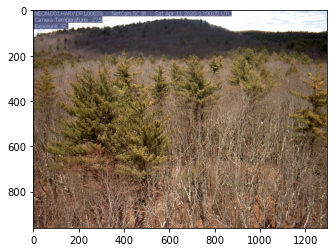

104.50863152649177


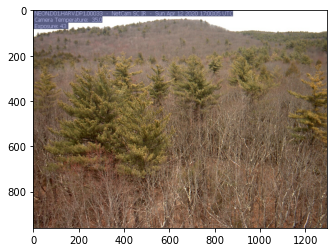

110.04593541023662


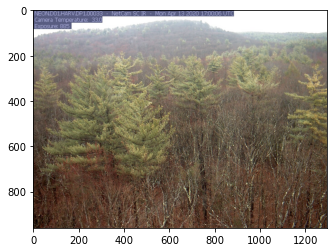

114.19337866512345


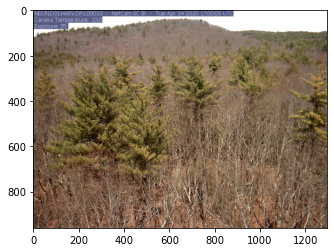

112.21431166409465


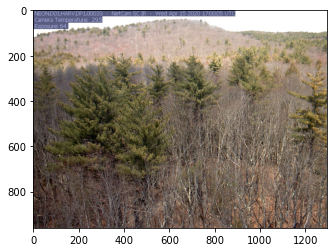

114.44419769161523


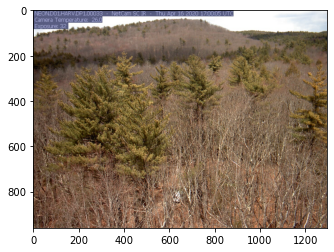

107.32559076003085


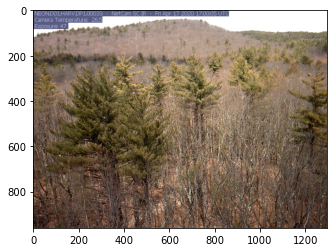

110.73122749485597


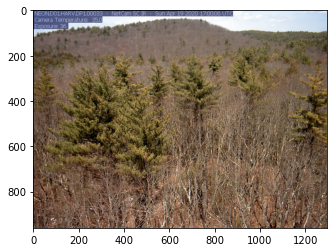

104.12026748971194


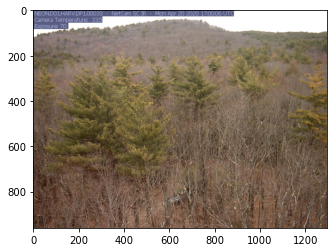

110.50411683384773


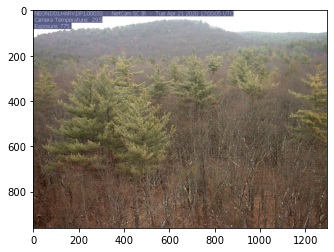

113.19283130787036


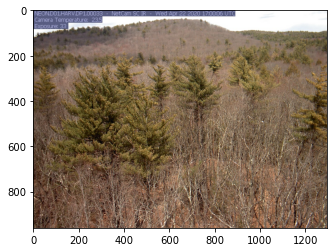

108.16809574331276


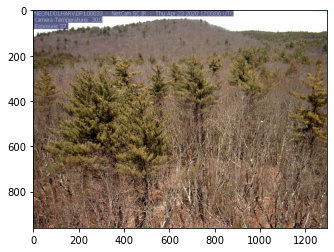

109.10759468235595


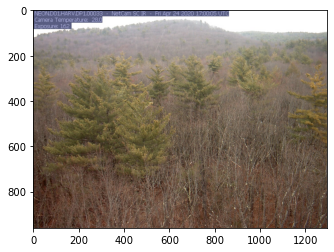

113.11084346064816


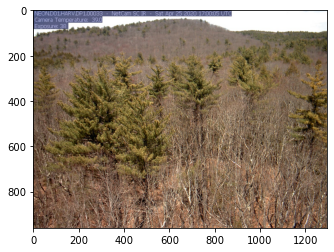

110.36994438014405


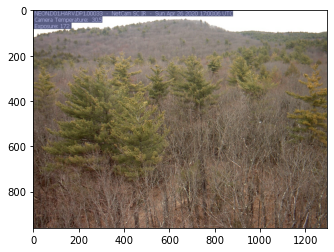

111.13967817644033


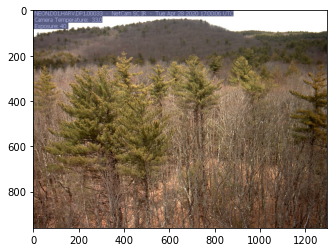

104.33796215920782


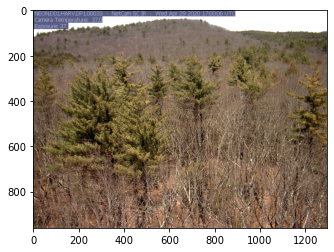

108.28412262088479


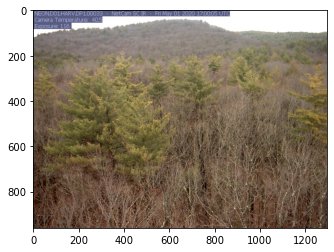

111.1336596579218


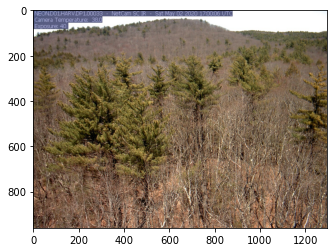

108.25305025077161


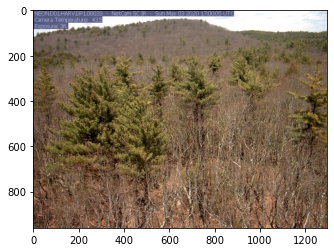

106.6789592978395


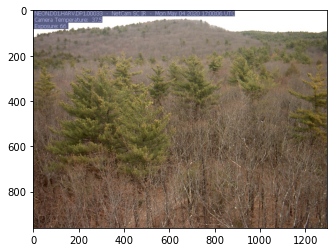

108.27578125000002


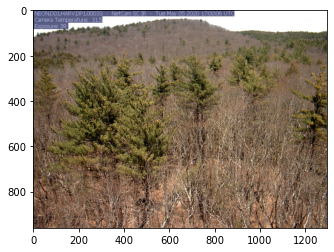

109.70636413323045


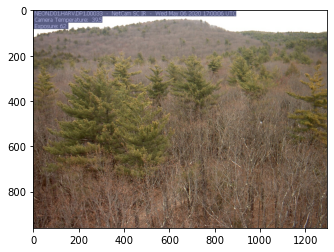

109.91111834490742


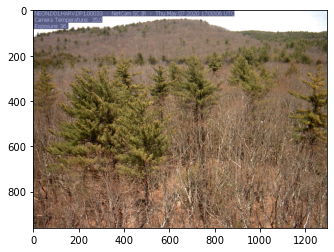

113.4119582690329


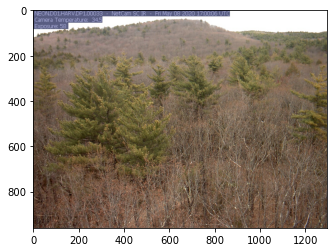

109.02235403806584


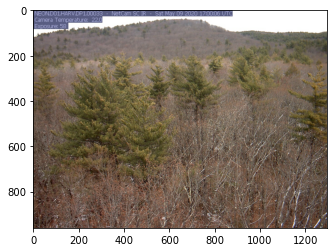

106.25084474665637


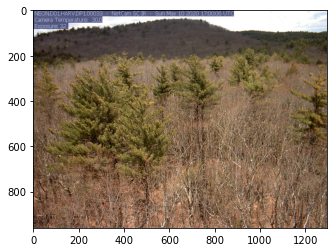

106.46079202031893


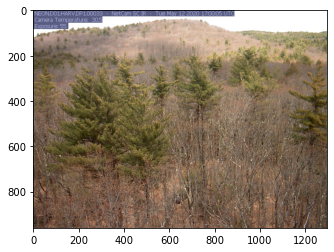

116.69446694958849


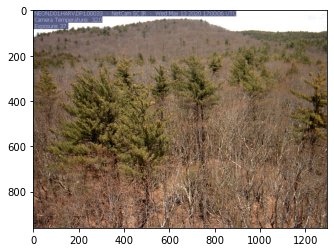

108.16425379372426


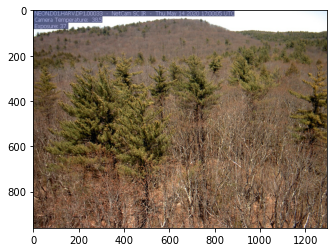

104.12294962062758


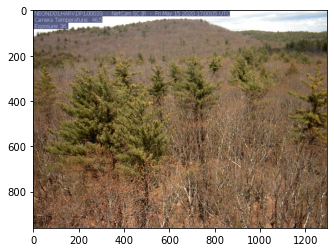

108.63666087962962


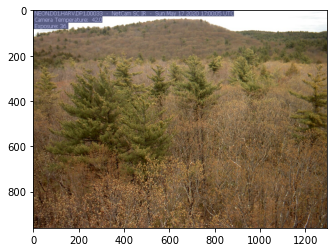

104.76485098379631


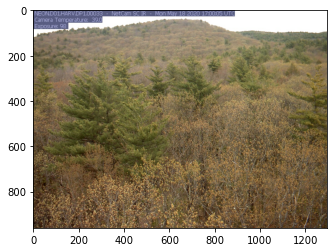

111.45947386188273


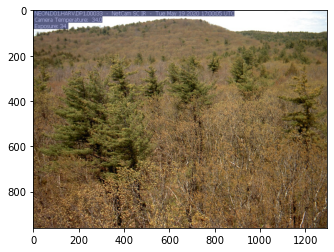

105.49657921810699


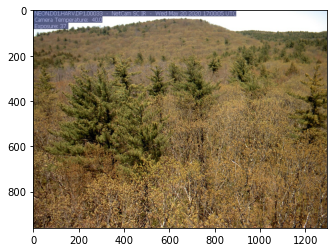

108.13575504758231


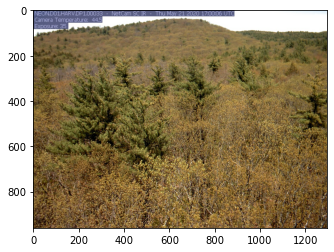

106.65893695344651


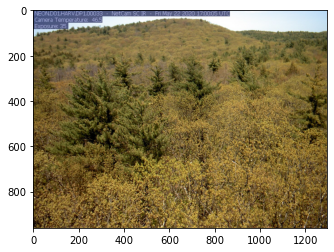

105.2958839699074


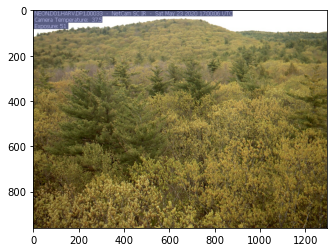

111.13446984310697


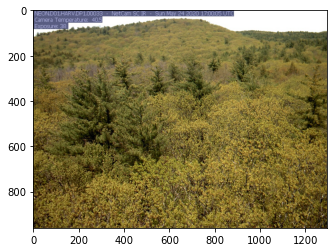

106.45046457047326


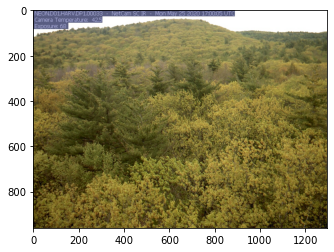

108.25354456018519


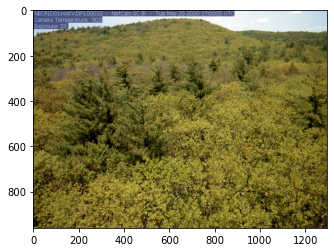

104.83891943158434


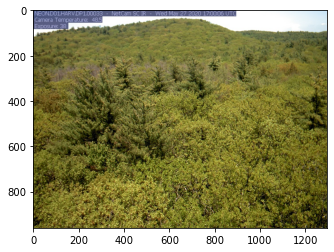

106.83972961676955


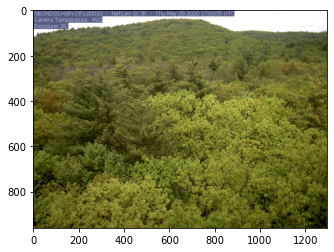

102.5253560635288


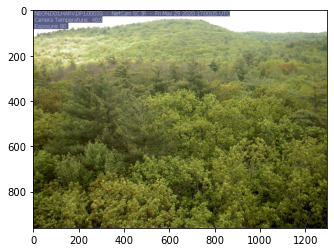

113.14855886702675


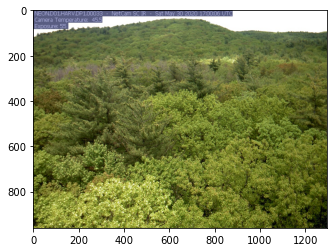

110.35808336548355


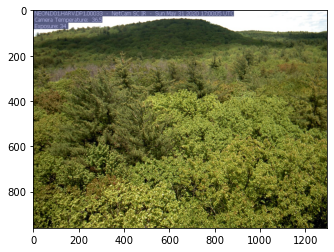

101.65454202031891


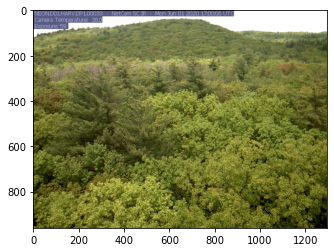

110.54906764403293


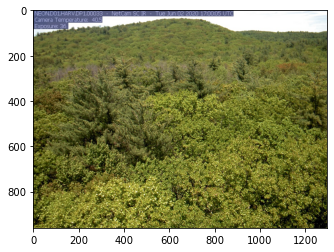

105.89455214763373


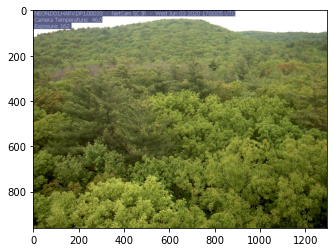

110.96875482253084


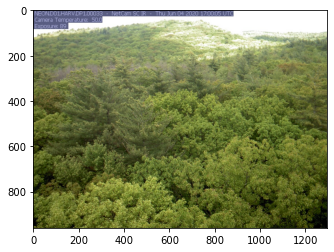

115.49665718235597


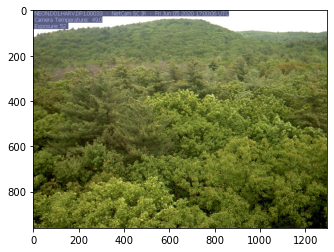

106.79166264789096


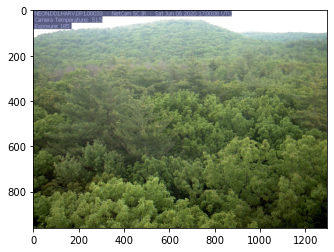

114.00720244984566


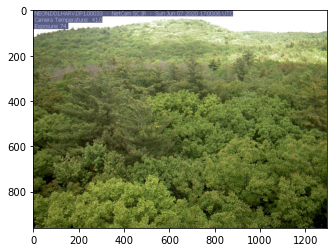

114.37821421682096


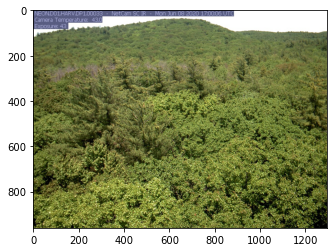

109.03936631944444


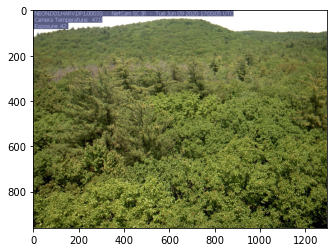

106.92831307870371


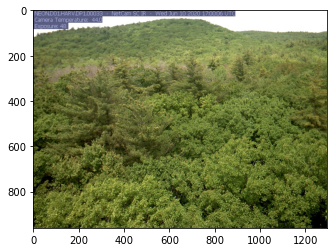

106.86478427211934


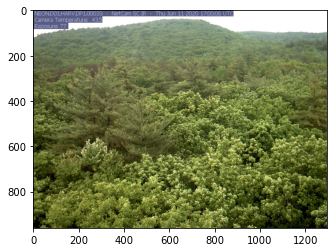

110.49425958076132


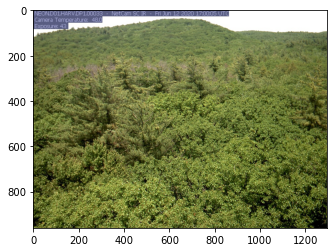

109.98823302469135


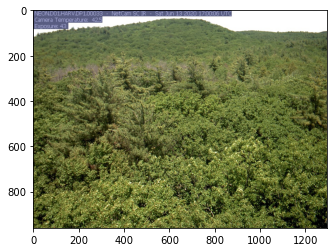

105.34013310185185


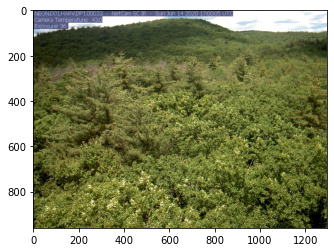

101.28643663194445


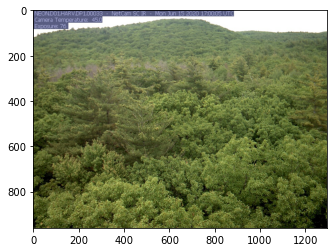

105.21202417695473


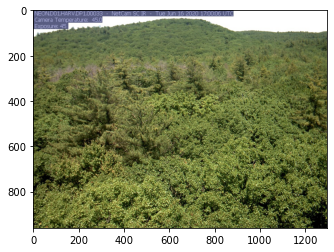

106.83692451131688


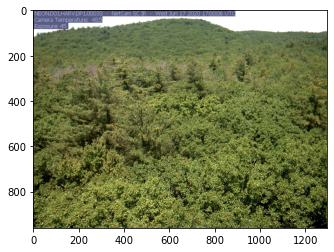

106.94342849794238


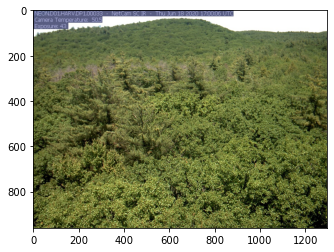

103.8851763438786


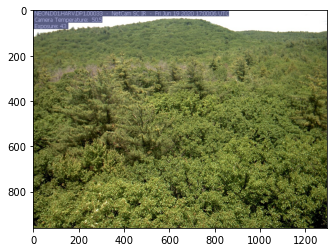

108.69266734182098


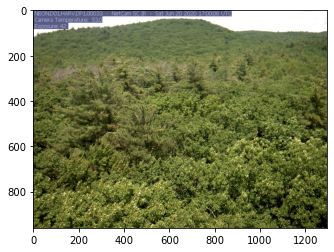

104.09623199588478


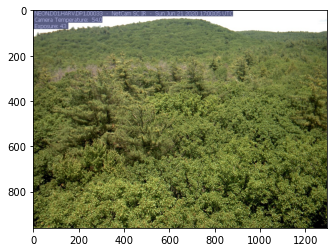

106.66098733281893


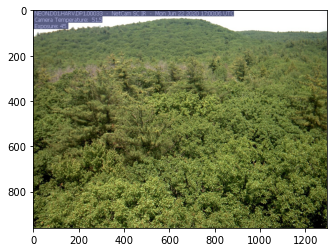

107.31468139146091


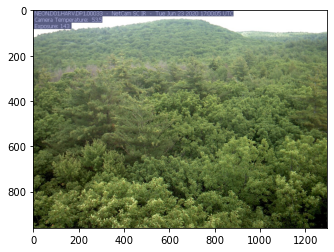

111.64905237268519


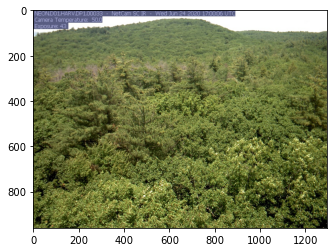

108.00471482767489


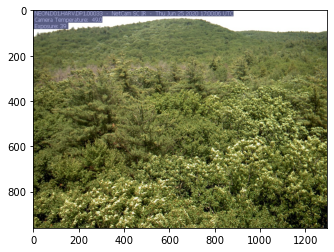

108.74832738554528


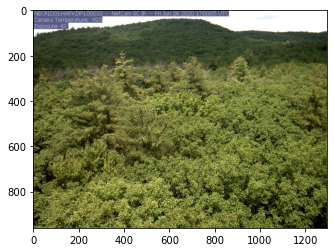

100.2930017039609


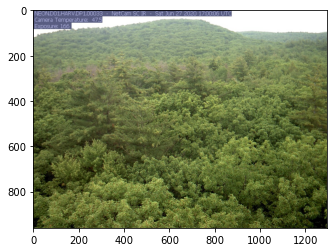

112.20162760416667


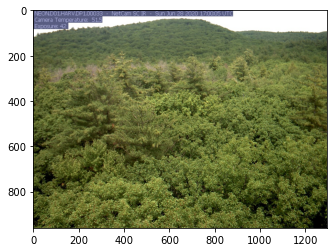

102.47448077417694


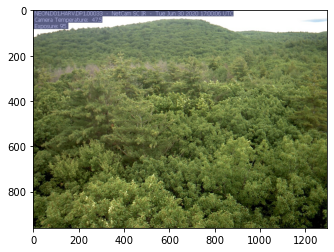

106.66408661265432


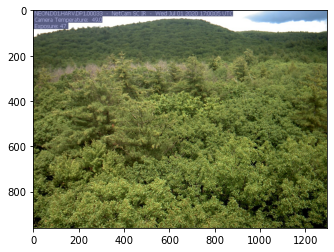

103.28954957561729


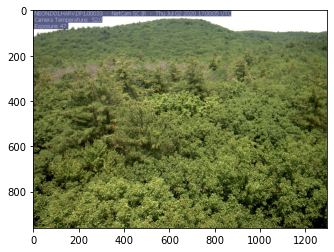

108.5896082497428


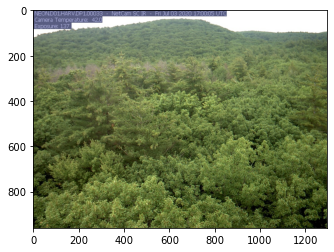

108.31444589120369


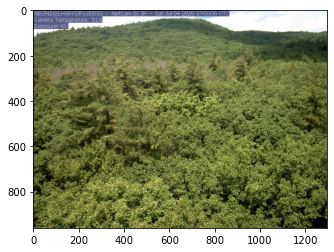

106.36258117926955


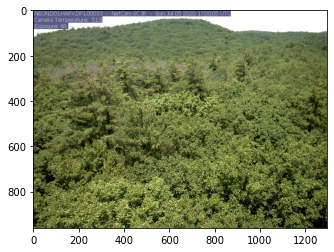

109.21716820987655


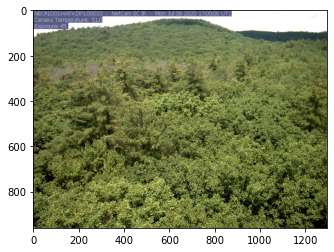

109.40886702674896


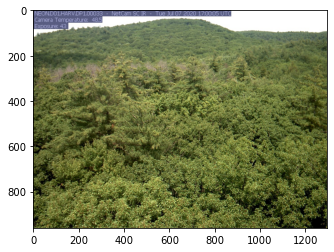

106.10854391718107


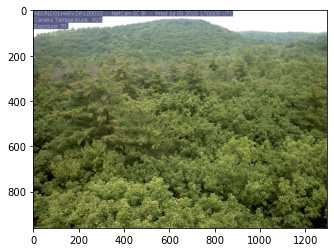

111.50268775720166


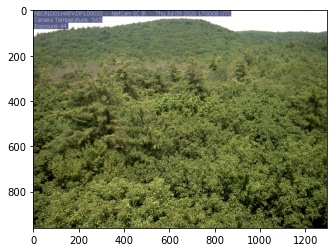

104.67937966177983


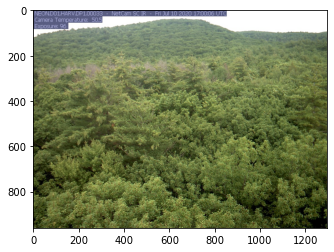

109.77520335005144


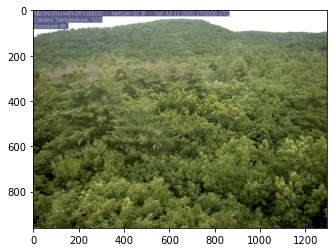

105.05494630915638


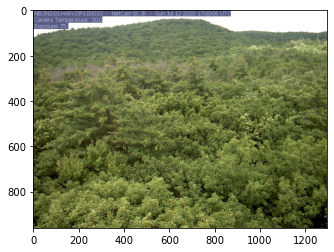

109.12068544238683


KeyboardInterrupt: 

In [37]:
for filename, gray_avg in below_threshold:
    image = cv2.imread(filename)
    rgb_img = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
    plt.imshow(rgb_img)
    plt.show()
    print(gray_avg)